In [32]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
import statsmodels.api as sm
import os
import plotly.express as px
import plotly.graph_objects as go
import nltk
import re
import string
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from sklearn.feature_extraction.text import TfidfVectorizer
from collections import Counter
from wordcloud import WordCloud
from sklearn.model_selection import StratifiedShuffleSplit

In [37]:
# Télécharger les ressources nécessaires
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('punkt_tab')
stop_words = set(stopwords.words('french'))


def clean_text(text):
    if isinstance(text, str):
        text = text.lower()  # Convertir en minuscule
        text = re.sub(f"[{string.punctuation}]", "", text)  # Supprimer la ponctuation
        text = re.sub(r"\d+", "", text)  # Supprimer les nombres
        tokens = word_tokenize(text)  # Tokenization
        tokens = [word for word in tokens if word not in stopwords.words('french')]  # Supprimer stopwords
        return " ".join(tokens)
    return ""

[nltk_data] Downloading package punkt to /Users/henri/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/henri/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt_tab to /Users/henri/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


In [3]:
liste_fichiers = os.listdir("../dataset")
liste_fichiers = ["../dataset/"+f for f in liste_fichiers if f.endswith('.csv')]
print("Liste des fichiers disponibles :", liste_fichiers)

# %%
dataset_init = pd.read_csv(liste_fichiers[2], sep='~').rename(columns={'id':'id_film'})
liste_fichiers.pop(2)

# %%
for f in liste_fichiers:
    data_inter = pd.read_csv(f, sep='~')
    dataset_init = pd.merge(dataset_init, data_inter, on='id_film')

Liste des fichiers disponibles : ['../dataset/categories.csv', '../dataset/acteurs.csv', '../dataset/films.csv', '../dataset/realisateurs.csv', '../dataset/critiques.csv', '../dataset/tags.csv', '../dataset/scenaristes.csv']


In [4]:
dataset_init.dropna(axis=1, how='all', inplace=True)

def clean_duplicate_columns(dataset_init):
    columns = dataset_init.columns
    columns_to_drop = []
    columns_to_rename = {}
    
    for col in columns:
        if col.endswith('_x') or col.endswith('_y'):
            base_col = col[:-2]
            col_x = f"{base_col}_x"
            col_y = f"{base_col}_y"
            
            if col_x in dataset_init.columns and col_y in dataset_init.columns:
                # Fusionner en priorisant les valeurs non nulles
                dataset_init[base_col] = dataset_init[col_x].combine_first(dataset_init[col_y])
                columns_to_drop.extend([col_x, col_y])
                columns_to_rename[base_col] = base_col
    
    dataset_init.drop(columns=columns_to_drop, inplace=True)
    dataset_init.rename(columns=columns_to_rename, inplace=True)
    return dataset_init

# Nettoyage des colonnes en double
dataset_init = clean_duplicate_columns(dataset_init)

In [8]:
dataset_init

,id_film,url,titre,synopsis,public,note_presse,nb_notes_presse,nb_critiques_presse,note_spectateurs,nb_notes_spectateurs,...,realisateur,id,auteur,note,contenu,likes,dislikes,tag,scenariste,date
0,42303,https://www.allocine.fr//film/fichefilm_gen_cf...,Permis de construire,"Dentiste à Paris, Romain vient de perdre son p...",NaN,1.8,4.0,4.0,2.5,2195.0,...,Eric Fraticelli,828,Mla,3.5,Une comédie française comme on les aime ! Le d...,22,5,Architecte / Architecture,Didier Bourdon,9-03-2022
1,42303,https://www.allocine.fr//film/fichefilm_gen_cf...,Permis de construire,"Dentiste à Paris, Romain vient de perdre son p...",NaN,1.8,4.0,4.0,2.5,2195.0,...,Eric Fraticelli,828,Mla,3.5,Une comédie française comme on les aime ! Le d...,22,5,Architecte / Architecture,Eric Fraticelli,9-03-2022
2,42303,https://www.allocine.fr//film/fichefilm_gen_cf...,Permis de construire,"Dentiste à Paris, Romain vient de perdre son p...",NaN,1.8,4.0,4.0,2.5,2195.0,...,Eric Fraticelli,828,Mla,3.5,Une comédie française comme on les aime ! Le d...,22,5,Héritage / Héritier / Héritière,Didier Bourdon,9-03-2022
3,42303,https://www.allocine.fr//film/fichefilm_gen_cf...,Permis de construire,"Dentiste à Paris, Romain vient de perdre son p...",NaN,1.8,4.0,4.0,2.5,2195.0,...,Eric Fraticelli,828,Mla,3.5,Une comédie française comme on les aime ! Le d...,22,5,Héritage / Héritier / Héritière,Eric Fraticelli,9-03-2022
4,42303,https://www.allocine.fr//film/fichefilm_gen_cf...,Permis de construire,"Dentiste à Paris, Romain vient de perdre son p...",NaN,1.8,4.0,4.0,2.5,2195.0,...,Eric Fraticelli,828,Mla,3.5,Une comédie française comme on les aime ! Le d...,22,5,Ils se mettent en scène,Didier Bourdon,9-03-2022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3108201,305037,https://www.allocine.fr//film/fichefilm_gen_cf...,The Wasteland,"Quelque part perdue dans le désert iranien, un...",NaN,3.6,10.0,10.0,3.4,24.0,...,Ahmad Bahrami,13924,Orno13,5.0,Un véritable chef d d'oeuvre de la part du tal...,0,0,Usine,Ahmad Bahrami,6-09-2023
3108202,305037,https://www.allocine.fr//film/fichefilm_gen_cf...,The Wasteland,"Quelque part perdue dans le désert iranien, un...",NaN,3.6,10.0,10.0,3.4,24.0,...,Ahmad Bahrami,13926,Bart Sampson,4.0,Film âpre et d'une beauté formelle époustoufla...,0,0,Art et essai,Ahmad Bahrami,6-09-2023
3108203,305037,https://www.allocine.fr//film/fichefilm_gen_cf...,The Wasteland,"Quelque part perdue dans le désert iranien, un...",NaN,3.6,10.0,10.0,3.4,24.0,...,Ahmad Bahrami,13926,Bart Sampson,4.0,Film âpre et d'une beauté formelle époustoufla...,0,0,Iran / Iraniens,Ahmad Bahrami,6-09-2023
3108204,305037,https://www.allocine.fr//film/fichefilm_gen_cf...,The Wasteland,"Quelque part perdue dans le désert iranien, un...",NaN,3.6,10.0,10.0,3.4,24.0,...,Ahmad Bahrami,13926,Bart Sampson,4.0,Film âpre et d'une beauté formelle époustoufla...,0,0,Noir et blanc (après 1960),Ahmad Bahrami,6-09-2023


In [ ]:
colonnes_stratifiees = ['note_presse', 'nb_notes_presse', 'nb_critiques_presse', 'note_spectateurs',
       'nb_notes_spectateurs', 'nb_critiques_spectateurs', 'duree',
       'distributeur', 'recompenses', 'type', 'box_office_france', 'langues',
       'couleur', 'nationalite', 'categorie', 'acteur', 'role', 'realisateur',
     'auteur', 'note',  'likes', 'dislikes', 'tag',
       'scenariste', 'date']

# Remplacement des valeurs NaN pour éviter des erreurs dans la stratification
dataset_init[colonnes_stratifiees] = dataset_init[colonnes_stratifiees].fillna("Inconnu")

for col in colonnes_stratifiees:
    print(f"Colonne : {col}")
    print(dataset_init[col].value_counts())
    print("\n")


# Filtrer les classes avec moins de 2 membres
for col in colonnes_stratifiees:
    counts = dataset_init[col].value_counts()
    rare_categories = counts[counts < 5].index
    dataset_init[col] = dataset_init[col].replace(rare_categories, "Autre")

# StratifiedShuffleSplit pour conserver les proportions
sss = StratifiedShuffleSplit(n_splits=1, test_size=100000 / len(dataset_init), random_state=42)

# Essayer avec une seule colonne d'abord
for train_idx, sample_idx in sss.split(dataset_init, dataset_init["categorie"]):
    df_sample = dataset_init.iloc[sample_idx]

# Vérifier la répartition avant/après
print("Répartition avant échantillonnage :")
print(dataset_init[colonnes_stratifiees].value_counts(normalize=True))

print("\nRépartition après échantillonnage :")
print(df_sample[colonnes_stratifiees].value_counts(normalize=True))

# Sauvegarde du dataset réduit
df_sample

Colonne : note_presse
note_presse
Inconnu    472472
3.2        234984
3.1        234080
3.8        188112
3.5        163288
3.4        145994
2.9        140594
2.8        137888
3.3        137422
2.3        131040
2.5        120720
3.6        116648
3.0        116572
3.9         90090
2.0         85320
2.4         72300
2.7         65344
2.6         62880
4.1         61680
2.2         53784
3.7         53506
4.0         45060
4.3         41328
2.1         37500
4.2         30720
4.4         17760
1.9         17280
1.7         11520
1.8         10800
1.6         10080
1.5          1440
Name: count, dtype: int64


Colonne : nb_notes_presse
nb_notes_presse
Inconnu    472472
12.0       202056
19.0       196368
11.0       159640
13.0       139184
15.0       131284
6.0        120446
10.0       108740
14.0       106972
17.0       101680
5.0         99576
9.0         99284
3.0         89056
24.0        85680
16.0        85104
34.0        70560
8.0         63840
21.0        62064
25.0        61

,id_film,url,titre,synopsis,public,note_presse,nb_notes_presse,nb_critiques_presse,note_spectateurs,nb_notes_spectateurs,...,realisateur,id,auteur,note,contenu,likes,dislikes,tag,scenariste,date
320724,236613,https://www.allocine.fr//film/fichefilm_gen_cf...,Mulan,Lorsque l’Empereur de Chine publie un décret s...,NaN,2.6,16.0,16.0,2.6,8000.0,...,Niki Caro,1213,Cinéphiles 44,4.0,“Mulan” est le remake en prises de vues réelle...,14,9,Evasion,Amanda Silver,30-11-2020
1233910,264525,https://www.allocine.fr//film/fichefilm_gen_cf...,Sons of Philadelphia,"Philadelphie. Il y a trente ans, la famille de...",Interdit - 12 ans,3.4,24.0,24.0,2.5,1478.0,...,Jérémie Guez,5029,lionelb30,2.0,Déjà vu et mieux traité. Cette histoire de riv...,5,1,Adaptation de roman,Jérémie Guez,26-05-2021
295055,236613,https://www.allocine.fr//film/fichefilm_gen_cf...,Mulan,Lorsque l’Empereur de Chine publie un décret s...,NaN,2.6,16.0,16.0,2.6,8000.0,...,Niki Caro,1234,Gilles Boudier,0.5,"Un navet ! Une série Z ! Pas de bande son, dia...",6,9,Sabre - épée et katana,Rick Jaffa,30-11-2020
1609680,271453,https://www.allocine.fr//film/fichefilm_gen_cf...,L'Etreinte,Margaux a perdu son mari et commence une nouve...,NaN,3.3,22.0,22.0,2.4,531.0,...,Ludovic Bergery,10483,Elisabeth G.,1.5,Un film gris et décevant que porte tant bien q...,8,1,Période de la vie : la cinquantaine,Ludovic Bergery,19-05-2021
2340859,279217,https://www.allocine.fr//film/fichefilm_gen_cf...,No Sudden Move,"Detroit, au milieu des années 1950. Des crimin...",NaN,4.0,5.0,5.0,2.9,484.0,...,Steven Soderbergh,2722,Hotinhere,3.0,"Porté par un casting séduisant, un polar diver...",1,0,Détroit,Ed Solomon,8-09-2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2160357,277532,https://www.allocine.fr//film/fichefilm_gen_cf...,Tout Simplement Noir,"JP, un acteur raté de 40 ans, décide d’organis...",NaN,3.8,32.0,32.0,2.8,9051.0,...,John Wax,1071,pliscal,0.5,"Je reviens de la séance, je suis démoralisé. J...",14,11,Acteur / Actrice,Jean-Pascal Zadi,8-07-2020
2503085,281251,https://www.allocine.fr//film/fichefilm_gen_cf...,Le Braquage du siècle,"Argentine, 2006. Un groupe de cambrioleurs s’a...",NaN,3.4,16.0,16.0,3.8,182.0,...,Ariel Winograd,5457,Christian L.,4.0,"Très bon petit film de braquage. C'est rapide,...",1,0,Adaptation de roman,Fernando Araujo,8-09-2021
344994,237864,https://www.allocine.fr//film/fichefilm_gen_cf...,Les Nouveaux mutants,"Rahne Sinclair, Illyana Rasputin, Sam Guthrie ...",Interdit - 12 ans,2.3,11.0,11.0,2.1,5452.0,...,Josh Boone,3527,Sébastien D,1.0,Le casting et les personnages sont affreux: la...,8,6,Meilleurs Blockbusters,Bob McLeod,26-08-2020
2744456,283751,https://www.allocine.fr//film/fichefilm_gen_cf...,Sweat,"Sylwia est belle, sportive, énergique. Elle es...",NaN,3.2,25.0,25.0,2.9,252.0,...,Magnus von Horn,11714,Charline_Mo,4.5,Une actrice formidable pour un film coup-de-po...,3,2,Harcèlement,Magnus von Horn,15-06-2022


In [21]:
df_sample["public"] = df_sample["public"].fillna("Tout public")   # Permet de remplir les valeurs null avec "Tout public"


/var/folders/9x/gl7s8kd16p7d9v5lgt59hqg40000gn/T/ipykernel_34571/2323243148.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [20]:
# Afficher le nombre de valeurs nulles par colonne
print("Valeurs nulles par colonne :")
print(df_sample.isnull().sum())

# Afficher le pourcentage de valeurs nulles par colonne
print("\nPourcentage de valeurs nulles par colonne :")
print((df_sample.isnull().sum() / len(df_sample)) * 100)

# Afficher un résumé général des données, y compris les valeurs uniques et les types de données
print("\nRésumé du dataset :")
print(df_sample.describe(include='all'))

Valeurs nulles par colonne :
id_film                     0
url                         0
titre                       0
synopsis                    0
public                      0
note_presse                 0
nb_notes_presse             0
nb_critiques_presse         0
note_spectateurs            0
nb_notes_spectateurs        0
nb_critiques_spectateurs    0
duree                       0
distributeur                0
recompenses                 0
type                        0
box_office_france           0
langues                     0
couleur                     0
nationalite                 0
categorie                   0
acteur                      0
role                        0
realisateur                 0
id                          0
auteur                      0
note                        0
contenu                     0
likes                       0
dislikes                    0
tag                         0
scenariste                  0
date                        0
dtype: int6

On enlève les colonnes qui ne sont pas pertinentes pour l'analyse et la prédiction

In [26]:
df_sample.drop(columns=['id_film', 'url', 'id'], inplace=True)

/var/folders/9x/gl7s8kd16p7d9v5lgt59hqg40000gn/T/ipykernel_34571/3912217573.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



On fait du texte mining sur les colonnes textuelles

/var/folders/9x/gl7s8kd16p7d9v5lgt59hqg40000gn/T/ipykernel_34571/156184380.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/9x/gl7s8kd16p7d9v5lgt59hqg40000gn/T/ipykernel_34571/156184380.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



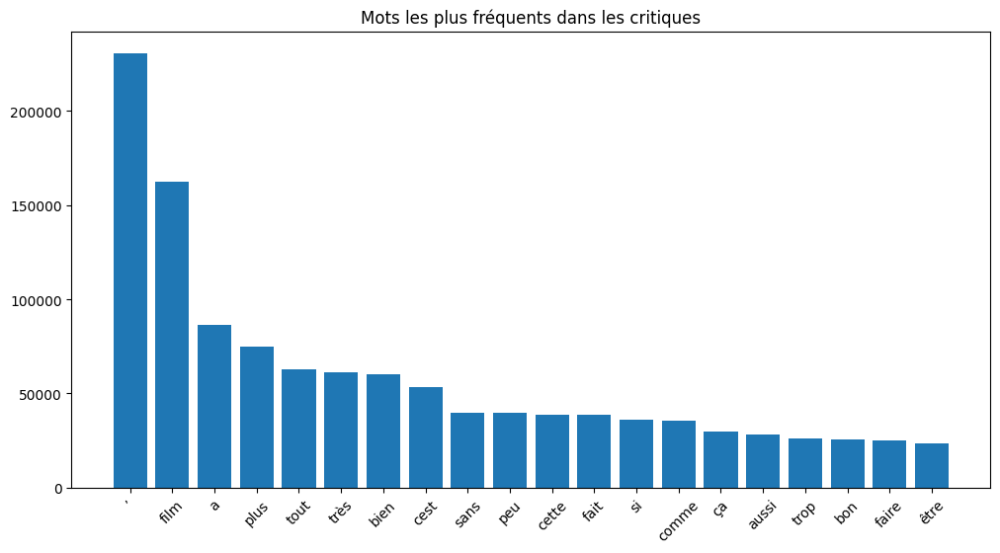

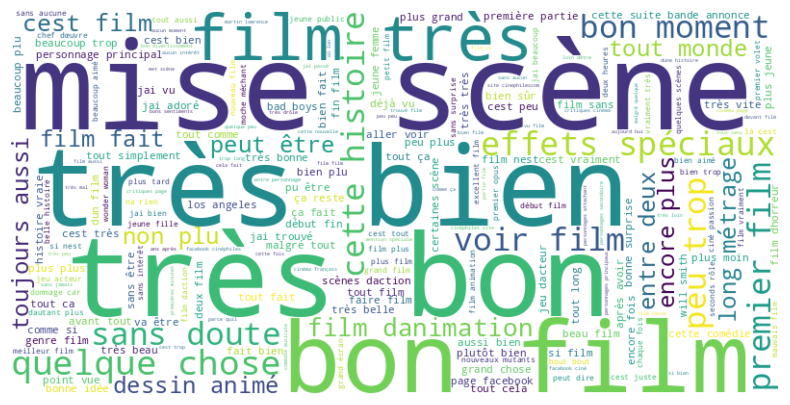

,titre,synopsis,public,note_presse,nb_notes_presse,nb_critiques_presse,note_spectateurs,nb_notes_spectateurs,nb_critiques_spectateurs,duree,...,auteur,note,contenu,likes,dislikes,tag,scenariste,date,cleaned_synopsis,cleaned_contenu
320724,Mulan,Lorsque l’Empereur de Chine publie un décret s...,Tout public,2.6,16.0,16.0,2.6,8000.0,456.0,115.0,...,Cinéphiles 44,4.0,“Mulan” est le remake en prises de vues réelle...,14,9,Evasion,Amanda Silver,30-11-2020,lorsque ’ empereur chine publie décret stipula...,“ mulan ” remake prises vues réelles dessin an...
1233910,Sons of Philadelphia,"Philadelphie. Il y a trente ans, la famille de...",Interdit - 12 ans,3.4,24.0,24.0,2.5,1478.0,80.0,90.0,...,lionelb30,2.0,Déjà vu et mieux traité. Cette histoire de riv...,5,1,Adaptation de roman,Jérémie Guez,26-05-2021,philadelphie a trente ans famille michael a re...,déjà vu mieux traité cette histoire rivalité e...
295055,Mulan,Lorsque l’Empereur de Chine publie un décret s...,Tout public,2.6,16.0,16.0,2.6,8000.0,456.0,115.0,...,Gilles Boudier,0.5,"Un navet ! Une série Z ! Pas de bande son, dia...",6,9,Sabre - épée et katana,Rick Jaffa,30-11-2020,lorsque ’ empereur chine publie décret stipula...,navet série z bande dialogues niais personnage...
1609680,L'Etreinte,Margaux a perdu son mari et commence une nouve...,Tout public,3.3,22.0,22.0,2.4,531.0,70.0,100.0,...,Elisabeth G.,1.5,Un film gris et décevant que porte tant bien q...,8,1,Période de la vie : la cinquantaine,Ludovic Bergery,19-05-2021,margaux a perdu mari commence nouvelle vie ’ i...,film gris décevant porte tant bien mal emmanue...
2340859,No Sudden Move,"Detroit, au milieu des années 1950. Des crimin...",Tout public,4.0,5.0,5.0,2.9,484.0,45.0,116.0,...,Hotinhere,3.0,"Porté par un casting séduisant, un polar diver...",1,0,Détroit,Ed Solomon,8-09-2021,detroit milieu années criminels divers horizon...,porté casting séduisant polar divertissant ple...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2160357,Tout Simplement Noir,"JP, un acteur raté de 40 ans, décide d’organis...",Tout public,3.8,32.0,32.0,2.8,9051.0,689.0,90.0,...,pliscal,0.5,"Je reviens de la séance, je suis démoralisé. J...",14,11,Acteur / Actrice,Jean-Pascal Zadi,8-07-2020,jp acteur raté ans décide ’ organiser première...,reviens séance démoralisé sens bête peutêtre m...
2503085,Le Braquage du siècle,"Argentine, 2006. Un groupe de cambrioleurs s’a...",Tout public,3.4,16.0,16.0,3.8,182.0,18.0,114.0,...,Christian L.,4.0,"Très bon petit film de braquage. C'est rapide,...",1,0,Adaptation de roman,Fernando Araujo,8-09-2021,argentine groupe cambrioleurs ’ apprête réalis...,très bon petit film braquage cest rapide ellip...
344994,Les Nouveaux mutants,"Rahne Sinclair, Illyana Rasputin, Sam Guthrie ...",Interdit - 12 ans,2.3,11.0,11.0,2.1,5452.0,362.0,93.0,...,Sébastien D,1.0,Le casting et les personnages sont affreux: la...,8,6,Meilleurs Blockbusters,Bob McLeod,26-08-2020,rahne sinclair illyana rasputin sam guthrie ro...,casting personnages affreux lesbienne sourcils...
2744456,Sweat,"Sylwia est belle, sportive, énergique. Elle es...",Tout public,3.2,25.0,25.0,2.9,252.0,49.0,106.0,...,Charline_Mo,4.5,Une actrice formidable pour un film coup-de-po...,3,2,Harcèlement,Magnus von Horn,15-06-2022,sylwia belle sportive énergique coach sportive...,actrice formidable film coupdepoing toxicité r...


In [38]:
# Appliquer le nettoyage sur les colonnes texte
df_sample['cleaned_synopsis'] = df_sample['synopsis'].apply(clean_text)
df_sample['cleaned_contenu'] = df_sample['contenu'].apply(clean_text)

# Vectorisation TF-IDF
vectorizer = TfidfVectorizer(max_features=1000)
tfidf_matrix = vectorizer.fit_transform(df_sample['cleaned_contenu'])

# Fréquence des mots
all_words = " ".join(df_sample['cleaned_contenu']).split()
word_freq = Counter(all_words)

# Affichage des mots les plus fréquents
most_common_words = word_freq.most_common(20)
words, counts = zip(*most_common_words)
plt.figure(figsize=(12, 6))
plt.bar(words, counts)
plt.xticks(rotation=45)
plt.title("Mots les plus fréquents dans les critiques")
plt.show()

# Génération d'un WordCloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(" ".join(all_words))
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()


df_sample

In [ ]:
# Appliquer le nettoyage sur les colonnes texte
df_sample['cleaned_synopsis'] = df_sample['synopsis'].apply(clean_text)
df_sample['cleaned_contenu'] = df_sample['contenu'].apply(clean_text)

# Vectorisation TF-IDF
vectorizer = TfidfVectorizer(max_features=1000)
tfidf_matrix = vectorizer.fit_transform(df_sample['cleaned_contenu'])

# Fréquence des mots
all_words = " ".join(df_sample['cleaned_contenu']).split()
word_freq = Counter(all_words)

# Affichage des mots les plus fréquents
most_common_words = word_freq.most_common(20)
words, counts = zip(*most_common_words)
plt.figure(figsize=(12, 6))
plt.bar(words, counts)
plt.xticks(rotation=45)
plt.title("Mots les plus fréquents dans les critiques")
plt.show()

# Génération d'un WordCloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(" ".join(all_words))
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()


df_sample

In [14]:
fig1 = px.histogram(df_sample, x='note_presse', nbins=20, title="Répartition des notes de la presse")
fig2 = px.histogram(df_sample, x='note_spectateurs', nbins=20, title="Répartition des notes des spectateurs")

# 2. Boxplot des notes spectateurs vs catégorie
fig3 = px.box(df_sample, x='categorie', y='note_spectateurs', title="Distribution des notes spectateurs par catégorie")

# 3. Répartition des films par catégorie
fig4 = px.pie(df_sample, names='categorie', title="Répartition des films par catégorie")

# 4. Evolution du box-office au fil du temps
fig5 = px.line(df_sample, x='date', y='box_office_france', title="Évolution du box-office au fil du temps")

# 5. Durée des films par catégorie
fig6 = px.box(df_sample, x='categorie', y='duree', title="Durée des films par catégorie")

# 6. Relation entre la durée du film et la note spectateur
fig7 = px.scatter(df_sample, x='duree', y='note_spectateurs', title="Durée du film vs Note spectateur")

# 7. Histogramme des durées des films
fig8 = px.histogram(df_sample, x='duree', nbins=20, title="Distribution des durées des films")

# 8. Corrélation entre nombre de notes spectateurs et leur note moyenne
fig9 = px.scatter(df_sample, x='nb_notes_spectateurs', y='note_spectateurs', title="Nombre de notes vs Note spectateurs")

# 9. Boxplot des box-offices par nationalité
fig10 = px.box(df_sample, x='nationalite', y='box_office_france', title="Box-office par nationalité")

# 10. Proportion de films en couleur vs noir et blanc
fig11 = px.pie(df_sample, names='couleur', title="Répartition des films en Couleur / Noir et Blanc")

# 11. Scatter des notes presse vs spectateurs
fig12 = px.scatter(df_sample, x='note_presse', y='note_spectateurs', title="Note presse vs Note spectateurs")



# 14. Evolution des notes spectateurs au fil du temps
fig15 = px.scatter(df_sample, x='date', y='note_spectateurs', title="Évolution des notes spectateurs dans le temps")

# Affichage des graphiques
fig1.show()
fig2.show()
fig3.show()
fig4.show()
fig5.show()
fig6.show()
fig7.show()
fig8.show()
fig9.show()
fig10.show()
fig11.show()
fig12.show()
fig15.show()